In [1]:
import os
import sys
sys.path.append(r"C:\Users\Alireza\Documents\Git\cosine-project-analysis")
from python.utils.basic_functions import *
from python.utils.image_analysis import *
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import re
from torchvision.transforms import ToPILImage


In [2]:
# set some paths
data_root = r"C:\Users\Alireza\OneDrive - Harvard University\Documents\cosine_preprocess_data"
save_path = os.path.join(data_root, "all_exp_summery_pd")
recon_exp_path = os.path.join(data_root, "recon_data")
proto_exp_path = os.path.join(data_root, "unit_proto")
scram_exp_path = os.path.join(data_root, "unit_scram")

# let's list all .mat files in the folders

# List .mat files in each directory
recon_exp_files = list_mat_files(recon_exp_path)
proto_exp_files = list_mat_files(proto_exp_path)
scram_exp_files = list_mat_files(scram_exp_path)


In [3]:
# let load the proto and corosponding mask if it posible plus the size 
# let save the proto and mask and other info in a pd
proto_and_mask_info = pd.DataFrame(columns=['exp_name', 'exp_id', 'proto_img',
                                            'proto_mask_exp', 'proto_mask_lin', 'proto_size',
                                            'proto_pos', 'chan_id', 'unit_id'])
c = 0
iamge_size = 256
for proto_exp_i in range(len(proto_exp_files)):
    # use the extract_info function to extract the information from the filename
    #proto_file = [f for f in proto_exp_files if f.count(f"expId{proto_exp_id+1:03d}")][0]
    proto_file = proto_exp_files[proto_exp_i]
    proto_exp_data = mat73.loadmat(os.path.join(proto_exp_path, proto_file))
    proto_exp_info = extract_info_proto_exp(proto_file)
    exp_name_common = '-'.join(proto_exp_info['exp_name'].split('-')[0:2])
    chan_id = proto_exp_info['chan']
    unit_id = proto_exp_info['unit']
    proto_exp_id = proto_exp_info['expId']


    # the scram exp data file name is formated like this [exp_name]_exp_idXXX_chanXX_unitX.mat for example like Caos-30112023-008_expId022_chan71_unit2
    # let's load the coresponded scram exp data which should be [exp_name_common]-*_chan[chan_id]_unit[unit_id].mat
    scram_exp_file = [f for f in scram_exp_files if (f.count(f"chan{chan_id:02d}") and f.count(f"unit{unit_id}") and f.count(exp_name_common))]
    # continue if the file is not found
    if (len(scram_exp_file) == 0) or (proto_exp_data['p_evol'] > .01):
        continue
    scram_exp_file = scram_exp_file[0]
    scram_exp_info = mat73.loadmat(os.path.join(scram_exp_path, scram_exp_file))
    proto_size = scram_exp_info['img_size']
    proto_pos = scram_exp_info['img_pos']

    proto_img = proto_exp_data['top_mean_img_selected']
    proto_mask_exp = scram_exp_info['overlapped_mask_exp']
    proto_mask_lin = scram_exp_info['overlapped_mask_lin']
    # if mask is not the size of image_size then resize it
    if proto_mask_exp.shape[0] != iamge_size:
        proto_mask_exp = cv2.resize(proto_mask_exp, (iamge_size, iamge_size))
    if proto_mask_lin.shape[0] != iamge_size:
        proto_mask_lin = cv2.resize(proto_mask_lin, (iamge_size, iamge_size))
    # if the proto_img is not the size of image_size then resize it
    if proto_img.shape[0] != iamge_size:
        proto_img = cv2.resize(proto_img, (iamge_size, iamge_size))
    # iloc with c
    proto_and_mask_info.loc[c] = [exp_name_common, proto_exp_id, proto_img, proto_mask_exp, proto_mask_lin, proto_size, proto_pos, chan_id, unit_id]
    c += 1
proto_and_mask_info['proto_img_torch'] = proto_and_mask_info['proto_img'].apply(uint8_image_to_pytorch)

In [4]:
# let loop over the recon exp files and load the data. and do coresponded analysis and same the result in a pd
num_of_last_gen_to_agrage = 3
pixels_per_deg = 128
# let have a list to ave all exp df and then concat them
exp_df_list = []
for recon_exp_i in range(len(recon_exp_files)):
    # let's load the file
    exp_file = recon_exp_files[recon_exp_i]
    # load the file
    recon_exp_data = mat73.loadmat(os.path.join(recon_exp_path, exp_file))
    # loop over the threads
    nThread = int(recon_exp_data['num_of_thread'])
    for iThread in range(nThread):
        exp_name = recon_exp_data['spike_fn']
        recon_exp_id = recon_exp_data['exp_i']
        bk_resp = recon_exp_data['bk_resp']
        evoke_resp = recon_exp_data['evoke_resp']
        unit_id = recon_exp_data['unit_ids']
        chan_id = recon_exp_data['chan_ids']
        all_image_names = recon_exp_data['all_img_name']

        if nThread > 1:
            target_img_uint8 = recon_exp_data['target_imgs_cell'][iThread][0]
            recon_img_uint8 = recon_exp_data['recon_img_cell'][iThread][0]
            init_img_uint8 = recon_exp_data['init_img_cell'][iThread][0]
            img_size = recon_exp_data['img_size'][iThread][0]
            img_poss = recon_exp_data['img_poss'][iThread][0]
            sampling_mode = recon_exp_data['sampling_mods'][iThread][0]
            score_mod = recon_exp_data['score_mods'][iThread][0]
            flat_mask = recon_exp_data['masks_cell'][iThread][0]
            target_resp = recon_exp_data['target_resps_cell'][iThread][0]
            cell_mean = recon_exp_data['pop_mean_call'][iThread][0]
            cell_std = recon_exp_data['pop_std_cell'][iThread][0]
        else:
            target_img_uint8 = recon_exp_data['target_imgs_cell'][iThread]
            recon_img_uint8 = recon_exp_data['recon_img_cell'][iThread]
            init_img_uint8 = recon_exp_data['init_img_cell'][iThread]
            img_size = recon_exp_data['img_size'][iThread]
            img_poss = recon_exp_data['img_poss'][iThread]
            sampling_mode = recon_exp_data['sampling_mods'][iThread]
            score_mod = recon_exp_data['score_mods'][iThread]
            flat_mask = recon_exp_data['masks_cell'][iThread]
            target_resp = recon_exp_data['target_resps_cell'][iThread]
            cell_mean = recon_exp_data['pop_mean_call'][iThread]
            cell_std = recon_exp_data['pop_std_cell'][iThread]



        init_img = uint8_image_to_pytorch(init_img_uint8)
        target_img = uint8_image_to_pytorch(target_img_uint8)
        recon_img = uint8_image_to_pytorch(recon_img_uint8)

        # let's get the real pos for the proto image and the mask based on the img_poss and img_size and save them all in a list
        # we have all proto_img_torch and proto_mask_tensor so let do it    
        real_pos_proto_img_list = [get_real_pos_img_torch(proto_and_mask_info['proto_img_torch'].iloc[i], proto_and_mask_info['proto_pos'].iloc[i], 
                                                    proto_and_mask_info['proto_size'].iloc[i], screen_size=img_size, grayness_level=0, pixels_per_deg=128) for i in range(len(proto_and_mask_info))]
        real_pos_mask_list = [get_real_pos_img_torch(torch.from_numpy(proto_and_mask_info['proto_mask_lin'].iloc[i]), proto_and_mask_info['proto_pos'].iloc[i],
                                            proto_and_mask_info['proto_size'].iloc[i], screen_size=img_size, grayness_level=0, pixels_per_deg=128) for i in range(len(proto_and_mask_info))]
        real_pos_bin_mask_list = [make_binary_mask_torch(mask) for mask in real_pos_mask_list]
        proto_chan_id = [proto_and_mask_info['chan_id'].iloc[i] for i in range(len(proto_and_mask_info))]
        proto_unit_id = [proto_and_mask_info['unit_id'].iloc[i] for i in range(len(proto_and_mask_info))]
        # let's convert the list to tensor
        real_pos_proto_img_tensor = torch.stack(real_pos_proto_img_list)
        real_pos_mask_tensor = torch.stack(real_pos_mask_list)
        real_pos_bin_mask_tensor = torch.stack(real_pos_bin_mask_list)
        real_pos_proto_img_tensor_masked = apply_mask_to_image_torch(real_pos_proto_img_tensor, real_pos_bin_mask_tensor)

        #
        
        img_size_pixels = img_size_pixels = int(img_size * pixels_per_deg)
        target_img = F.resize(target_img, [img_size_pixels, img_size_pixels])
        recon_img = F.resize(recon_img, [img_size_pixels, img_size_pixels])
        init_img = F.resize(init_img, [img_size_pixels, img_size_pixels])

        target_img_masked = apply_mask_to_image_torch(target_img, real_pos_bin_mask_tensor)
        recon_img_masked = apply_mask_to_image_torch(recon_img, real_pos_bin_mask_tensor)
        init_img_masked = apply_mask_to_image_torch(init_img, real_pos_bin_mask_tensor)



        # let compute the lpips similarity between the target_img and the proto_img
        similarity_map_target, similarity_map_norm_target = compute_lpips_similarity(target_img, real_pos_proto_img_tensor, net_type='alex')

        # apply the mask to the similarity_map_img
        similarity_map_masked_target = apply_mask_to_image_torch(similarity_map_target, real_pos_bin_mask_tensor)

        # let caculate the mean of the similarity_map_masked for each image
        #similarity_map_masked_mean_target = similarity_map_target.mean(dim=[1, 2, 3])
        similarity_map_masked_mean_target = average_nonzero(similarity_map_masked_target, dims=[1, 2, 3])

        # let's do the same for the recon_img
        similarity_map_recon, similarity_map_norm_recon = compute_lpips_similarity(recon_img, real_pos_proto_img_tensor, net_type='alex')
        similarity_map_masked_recon = apply_mask_to_image_torch(similarity_map_recon, real_pos_bin_mask_tensor)
        #similarity_map_masked_mean_recon = similarity_map_recon.mean(dim=[1, 2, 3])
        similarity_map_masked_mean_recon = average_nonzero(similarity_map_masked_recon, dims=[1, 2, 3])

        # let's do the same for the init_img
        similarity_map_init, similarity_map_norm_init = compute_lpips_similarity(init_img, real_pos_proto_img_tensor, net_type='alex')
        similarity_map_masked_init = apply_mask_to_image_torch(similarity_map_init, real_pos_bin_mask_tensor)
        #similarity_map_masked_mean_init = similarity_map_init.mean(dim=[1, 2, 3])
        similarity_map_masked_mean_init = average_nonzero(similarity_map_masked_init, dims=[1, 2, 3])

        # let get other image distance metrics
        l2_target_proto = compute_l2_distance(target_img_masked, real_pos_proto_img_tensor_masked)
        l2_recon_proto = compute_l2_distance(recon_img_masked, real_pos_proto_img_tensor_masked)
        l2_init_proto = compute_l2_distance(init_img_masked, real_pos_proto_img_tensor_masked)
        l2_init_recon = compute_l2_distance(init_img_masked, recon_img_masked)
        l2_init_target = compute_l2_distance(init_img_masked, target_img_masked)

        mse_target_proto = compute_mse(target_img_masked, real_pos_proto_img_tensor_masked)
        mse_recon_proto = compute_mse(recon_img_masked, real_pos_proto_img_tensor_masked)
        mse_init_proto = compute_mse(init_img_masked, real_pos_proto_img_tensor_masked)
        mse_init_recon = compute_mse(init_img_masked, recon_img_masked)
        mse_init_target = compute_mse(init_img_masked, target_img_masked)


        sub_resp = evoke_resp - bk_resp
        all_image_names = [all_image_names[i][0] for i in range(len(all_image_names))]
        is_gen, block_ids, thread_ids, gen_ids, counters, is_nat, nat_gen = \
                    process_gen_image_strings(all_image_names)
        thread_mask = is_gen & (thread_ids == iThread)
        this_tread_sub_resp = sub_resp[:, thread_mask]
        this_tread_gen_ids = gen_ids[thread_mask]
        gen_resp_means, gen_stds, gen_sems, unique_gens = analyze_by_gen(sub_resp[:, thread_mask], gen_ids[thread_mask])
        delta_resp = this_tread_sub_resp - target_resp[:, None]
        delta_resp_each_gen = gen_resp_means - target_resp[:, None]

        delta_resp_masked = delta_resp[flat_mask, :]
        delta_resp_each_gen_masked = delta_resp_each_gen[flat_mask, :]
        slope_vec_masked, intercept_vec_masked, pValue_vec_masked, r2_vec_masked = get_lreg_sklearn_all_units(delta_resp_masked, this_tread_gen_ids, 1, 1)

        first_gen_delta_resp = delta_resp_each_gen_masked[:, 0]
        last_gen_delta_resp = delta_resp_each_gen_masked[:, -num_of_last_gen_to_agrage-1:-1].mean(axis=1) 

        improvement_index =  (np.abs(first_gen_delta_resp)-np.abs(last_gen_delta_resp))/np.abs(first_gen_delta_resp)

        first_gen_resp = gen_resp_means[flat_mask, 0]
        last_gen_resp = gen_resp_means[flat_mask, -num_of_last_gen_to_agrage-1:-1].mean(axis=1)

        unit_id_masked = unit_id[flat_mask]
        chan_id_masked = chan_id[flat_mask]
        cell_mean_masked = cell_mean[flat_mask]
        cell_std_masked = cell_std[flat_mask]
        target_resp_masked = target_resp[flat_mask]
        # let have df with this columns ['exp_name', 'exp_id', 'unit_id_masked', 'chan_id_masked', 'delta_resp_each_gen_masked', 'slope_vec_masked' 'intercept_vec_masked', 'pValue_vec_masked', 'r2_vec_masked']
        this_exp_thread_results = pd.DataFrame(columns=['exp_name', 'exp_id', 'unit_id', 'chan_id',
                                                        'iThread', 'score_mods', 'sampling_mods', 'img_size', 'img_poss',
                                                        'delta_resp_first_gen', 'delta_resp_last_gen', 'slope_vec', 'intercept_vec', 'pValue_vec', 'r2_vec',
                                                        'resp_to_target', 'cell_mean', 'cell_std', 'first_gen_resp', 'last_gen_resp', 'improvement_index',
                                                        'lpips_similarity_mean_target', 'lpips_similarity_mean_recon', 'lpips_similarity_mean_init',
                                                        'L2_target_proto', 'L2_recon_proto', 'L2_init_proto', 'L2_init_recon', 'L2_init_target',
                                                        'MSE_target_proto', 'MSE_recon_proto', 'MSE_init_proto', 'MSE_init_recon', 'MSE_init_target'])
        this_exp_thread_results['exp_name'] = [exp_name]*len(unit_id_masked)
        this_exp_thread_results['exp_id'] = [recon_exp_id]*len(unit_id_masked)
        this_exp_thread_results['unit_id'] = unit_id_masked
        this_exp_thread_results['chan_id'] = chan_id_masked
        this_exp_thread_results['delta_resp_first_gen'] = first_gen_delta_resp
        this_exp_thread_results['delta_resp_last_gen'] = last_gen_delta_resp
        this_exp_thread_results['slope_vec'] = -1*slope_vec_masked
        this_exp_thread_results['intercept_vec'] = intercept_vec_masked
        this_exp_thread_results['pValue_vec'] = pValue_vec_masked
        this_exp_thread_results['r2_vec'] = r2_vec_masked
        this_exp_thread_results['iThread'] = [iThread]*len(unit_id_masked)
        this_exp_thread_results['score_mods'] = [score_mod]*len(unit_id_masked)
        this_exp_thread_results['sampling_mods'] = [sampling_mode]*len(unit_id_masked)
        this_exp_thread_results['img_size'] = [img_size]*len(unit_id_masked)
        this_exp_thread_results['img_poss'] = [img_poss]*len(unit_id_masked)
        this_exp_thread_results['resp_to_target'] = target_resp_masked
        this_exp_thread_results['cell_mean'] = cell_mean_masked
        this_exp_thread_results['cell_std'] = cell_std_masked
        this_exp_thread_results['first_gen_resp'] = first_gen_resp
        this_exp_thread_results['last_gen_resp'] = last_gen_resp
        this_exp_thread_results['improvement_index'] = improvement_index

        # let add columns for the lpips_similarity_mean for the target_img and the recon_img, in the coresponed rows based on the unit_id_masked and chan_id_masked and proto_chan_id and proto_unit_id if they are the same otherwise np.nan
        this_exp_thread_results['lpips_similarity_mean_target'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['lpips_similarity_mean_recon'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['lpips_similarity_mean_init'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['L2_target_proto'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['L2_recon_proto'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['L2_init_proto'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['L2_init_recon'] = np.repeat(l2_init_recon[0].item(), len(unit_id_masked))
        this_exp_thread_results['L2_init_target'] = np.repeat(l2_init_target[0].item(), len(unit_id_masked))
        this_exp_thread_results['MSE_target_proto'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['MSE_recon_proto'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['MSE_init_proto'] = [np.nan]*len(unit_id_masked)
        this_exp_thread_results['MSE_init_recon'] = np.repeat(mse_init_recon[0].item(), len(unit_id_masked))
        this_exp_thread_results['MSE_init_target'] = np.repeat(mse_init_target[0].item(), len(unit_id_masked)) 

        for i in range(len(unit_id_masked)):
            # let find the index of the proto_chan_id and proto_unit_id
            index = (proto_chan_id == chan_id_masked[i]) & (proto_unit_id == unit_id_masked[i])
            if np.sum(index) > 0:
                # if there is more than one index then take the first one
                index = np.where(index)[0][0]
                this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
                this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
                this_exp_thread_results['lpips_similarity_mean_init'].iloc[i] = similarity_map_masked_mean_init[index].item()
                this_exp_thread_results['L2_target_proto'].iloc[i] = l2_target_proto[index].item()
                this_exp_thread_results['L2_recon_proto'].iloc[i] = l2_recon_proto[index].item()
                this_exp_thread_results['L2_init_proto'].iloc[i] = l2_init_proto[index].item()
                this_exp_thread_results['MSE_target_proto'].iloc[i] = mse_target_proto[index].item()
                this_exp_thread_results['MSE_recon_proto'].iloc[i] = mse_recon_proto[index].item()
                this_exp_thread_results['MSE_init_proto'].iloc[i] = mse_init_proto[index].item()
                
        
        exp_df_list.append(this_exp_thread_results)
        
all_recon_exp_results_df = pd.concat(exp_df_list, ignore_index=True)

c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\Documents\Git\cosine-project-analysis\python\utils\basic_functions.py:216: RuntimeWarning: Mean of empty slice
  resp_zs = (resp - np.nanmean(resp, axis=1, keepdims=True)) / np.nanstd(resp, axis=1, keepdims=True)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\numpy\lib\nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]


c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [on]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:196: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_target'].iloc[i] = similarity_map_masked_mean_target[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:197: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_exp_thread_results['lpips_similarity_mean_recon'].iloc[i] = similarity_map_masked_mean_recon[index].item()
C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\864340427.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See th

In [5]:
# let save the all_recon_exp_results_df, use to to_hdf
all_recon_exp_results_df.to_hdf(save_path, key='all_recon_exp_results_df', mode='w')
# let load the all_recon_exp_results_df
#all_recon_exp_results_df = pd.read_hdf(save_path, key='all_recon_exp_results_df')

C:\Users\Alireza\AppData\Local\Temp\ipykernel_28396\2606070998.py:2: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block2_values] [items->Index(['exp_name', 'exp_id', 'score_mods', 'sampling_mods', 'img_size',
       'img_poss'],
      dtype='object')]

  all_recon_exp_results_df.to_hdf(save_path, key='all_recon_exp_results_df', mode='w')


In [6]:
# let asign area to each row. folowing this map
# V1: 1-32
# V4: 33-64
# IT: 65-96    
def assign_area(row, animal='Caos'):
    if animal == 'Caos':
        if row['chan_id'] in range(1, 33):
            return 'V1'
        elif row['chan_id'] in range(33, 65):
            return 'V4'
        elif row['chan_id'] in range(65, 97):
            return 'IT'
    else:
        raise ValueError('animal is not supported')
all_recon_exp_results_df['area'] = all_recon_exp_results_df.apply(assign_area, axis=1)

In [7]:
all_recon_exp_results_df['resp_to_target_norm'] = (all_recon_exp_results_df['resp_to_target'].values - all_recon_exp_results_df['cell_mean'].values) / all_recon_exp_results_df['cell_std'].values

Text(0.5, 1.0, 'r=0.04, p=0.04')

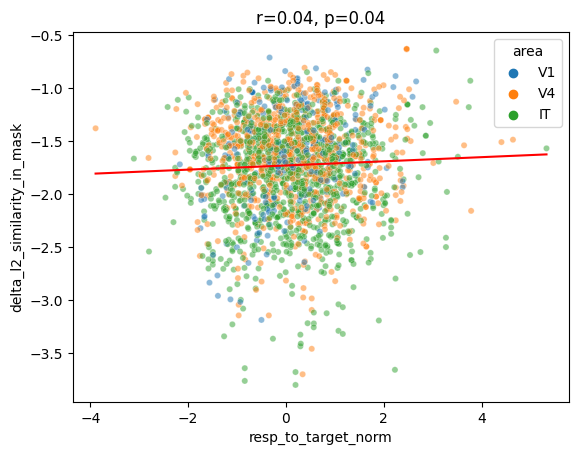

In [12]:
# let find corolation between the resonce to the target and similarity of unit proto and target_img
# let's plot the scatter plot
import scipy.stats as stats

all_recon_exp_results_df['delta_l2_similarity_in_mask'] = -(all_recon_exp_results_df['L2_target_proto'] / all_recon_exp_results_df['L2_init_target'])

x1 = all_recon_exp_results_df['resp_to_target_norm'].values  # Ensure it's a numpy array
y1 = all_recon_exp_results_df['delta_l2_similarity_in_mask']  # Ensure it's a numpy array

fig, ax = plt.subplots()

sns.scatterplot(data=all_recon_exp_results_df, x='resp_to_target_norm', y='delta_l2_similarity_in_mask', ax=ax, hue='area', alpha=.5, s=20)
# let's add the linear regression line
x1_clean, y1_clean = clean_data(x1, y1)  # Clean data to remove NaNs

slope, intercept, r_value, p_value, std_err = stats.linregress(x1_clean, y1_clean)
x = np.array([x1_clean.min(), x1_clean.max()])
y = slope * x + intercept
ax.plot(x, y, color='r')
ax.set_title(f'r={r_value:.2f}, p={p_value:.2f}')

Text(0.5, 1.0, 'r=-0.03, p=0.18')

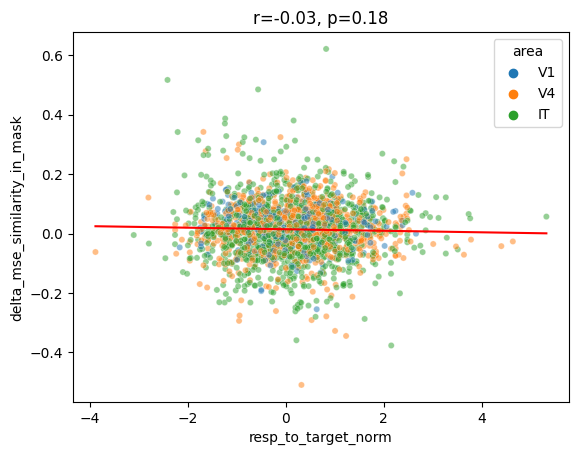

In [9]:
# let find corolation between the resonce to the target and similarity of unit proto and target_img
# let's plot the scatter plot
import scipy.stats as stats

all_recon_exp_results_df['delta_mse_similarity_in_mask'] = -(all_recon_exp_results_df['MSE_target_proto'] - all_recon_exp_results_df['MSE_recon_proto'])
x1 = all_recon_exp_results_df['resp_to_target_norm'].values  # Ensure it's a numpy array
y1 = all_recon_exp_results_df['delta_mse_similarity_in_mask']  # Ensure it's a numpy array

fig, ax = plt.subplots()

sns.scatterplot(data=all_recon_exp_results_df, x='resp_to_target_norm', y='delta_mse_similarity_in_mask', ax=ax, hue='area', alpha=.5, s=20)
# let's add the linear regression line
x1_clean, y1_clean = clean_data(x1, y1)  # Clean data to remove NaNs

slope, intercept, r_value, p_value, std_err = stats.linregress(x1_clean, y1_clean)
x = np.array([x1_clean.min(), x1_clean.max()])
y = slope * x + intercept
ax.plot(x, y, color='r')
ax.set_title(f'r={r_value:.2f}, p={p_value:.2f}')

Text(0.5, 1.0, 'r=-0.01, p=0.62')

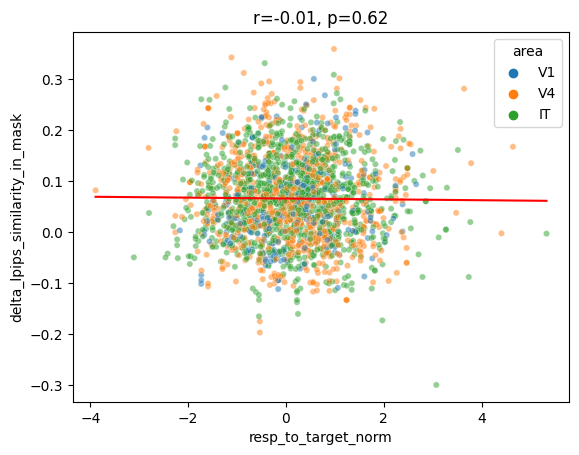

In [10]:
# let find corolation between the resonce to the target and similarity of unit proto and target_img
# let's plot the scatter plot
import scipy.stats as stats

all_recon_exp_results_df['delta_lpips_similarity_in_mask'] = all_recon_exp_results_df['lpips_similarity_mean_target'] - all_recon_exp_results_df['lpips_similarity_mean_init']
x1 = all_recon_exp_results_df['resp_to_target_norm'].values  # Ensure it's a numpy array
y1 = all_recon_exp_results_df['delta_lpips_similarity_in_mask']  # Ensure it's a numpy array

fig, ax = plt.subplots()

sns.scatterplot(data=all_recon_exp_results_df, x='resp_to_target_norm', y='delta_lpips_similarity_in_mask', ax=ax, hue='area', alpha=.5, s=20)
# let's add the linear regression line
x1_clean, y1_clean = clean_data(x1, y1)  # Clean data to remove NaNs

slope, intercept, r_value, p_value, std_err = stats.linregress(x1_clean, y1_clean)
x = np.array([x1_clean.min(), x1_clean.max()])
y = slope * x + intercept
ax.plot(x, y, color='r')
ax.set_title(f'r={r_value:.2f}, p={p_value:.2f}')


In [ ]:
# if slope is positive and pValue is less than alpha then it is a sucsessful improvement so asign 1 to and -1 to unsucsessful and 0 to not significant
alpha = .05
all_recon_exp_results_df['improvement'] = all_recon_exp_results_df.apply(lambda row: 1 if (row['slope_vec'] > 0) and (row['pValue_vec'] < alpha) else -1 if (row['slope_vec'] < 0) and (row['pValue_vec'] < alpha) else 0, axis=1)

In [ ]:
sum(all_recon_exp_results_df['score_mods'] == 'cosine')

191

(-0.3, 1.0)

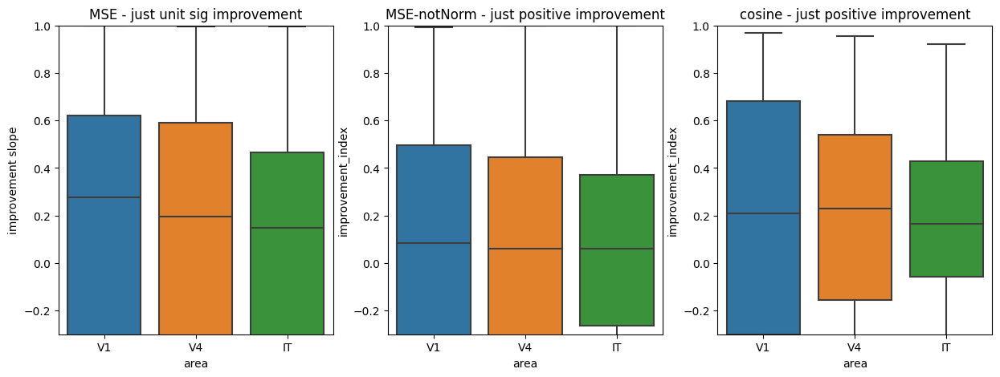

In [ ]:
# let see wheter the slope distribution is different between the areas
# also let filter all row with 'sampling_mods' == 'all' and seprate the data based on the 'score_mods'

# let plot the slope distribution using the seaborn boxplot
ax_lim = [-.3, 1]
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['score_mods'] == 'MSE')
# make this order ['V1', 'V4', 'IT']
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='area', y='improvement_index', ax=ax[0], order=['V1', 'V4', 'IT'])
ax[0].set_title('MSE - just unit sig improvement')
ax[0].set_ylim(ax_lim)
ax[0].set_ylabel('improvement slope')

row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['score_mods'] == 'MSE-notNorm')
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='area', y='improvement_index', ax=ax[1])
ax[1].set_title('MSE-notNorm - just positive improvement')
ax[1].set_ylim(ax_lim)

row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['score_mods'] == 'cosine')
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='area', y='improvement_index', ax=ax[2])
ax[2].set_title('cosine - just positive improvement')
ax[2].set_ylim(ax_lim)



Text(0, 0.5, 'improvement slope - just positive')

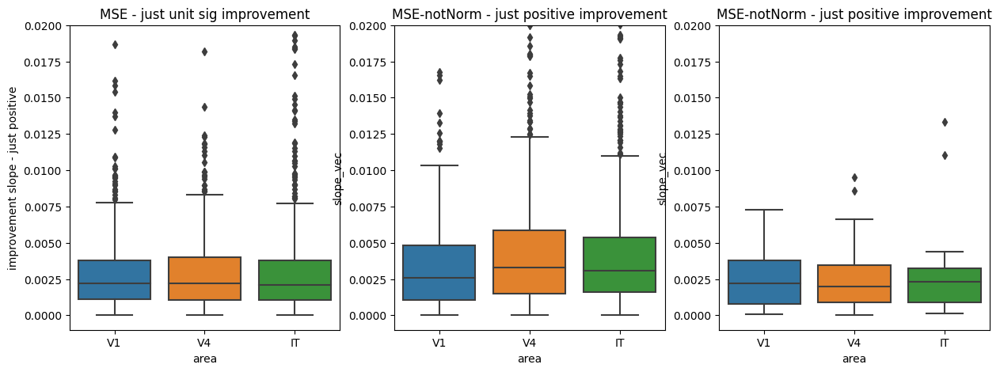

In [ ]:
# let see wheter the slope distribution is different between the areas
# also let filter all row with 'sampling_mods' == 'all' and seprate the data based on the 'score_mods'

# let plot the slope distribution using the seaborn boxplot
ax_lim = [-.001, .02]
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['slope_vec'] > 0) &\
    (all_recon_exp_results_df['score_mods'] == 'MSE')
# make this order ['V1', 'V4', 'IT']
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='area', y='slope_vec', ax=ax[0], order=['V1', 'V4', 'IT'])
ax[0].set_title('MSE - just unit sig improvement')
ax[0].set_ylim(ax_lim)
ax[0].set_ylabel('improvement slope')

row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['slope_vec'] > 0) &\
    (all_recon_exp_results_df['score_mods'] == 'MSE-notNorm')
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='area', y='slope_vec', ax=ax[1])
ax[1].set_title('MSE-notNorm - just positive improvement')
ax[1].set_ylim(ax_lim)
ax[0].set_ylabel('improvement slope - just positive')


row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['slope_vec'] > 0) &\
    (all_recon_exp_results_df['score_mods'] == 'cosine')
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='area', y='slope_vec', ax=ax[2])
ax[2].set_title('MSE-notNorm - just positive improvement')
ax[2].set_ylim(ax_lim)
ax[0].set_ylabel('improvement slope - just positive')


In [ ]:
all_recon_exp_results_df.columns

[Text(0, 0, '1.0'),
 Text(1, 0, '2.0'),
 Text(2, 0, '3.0'),
 Text(3, 0, '4.0'),
 Text(4, 0, '5.0'),
 Text(5, 0, '6.0'),
 Text(6, 0, '7.0'),
 Text(7, 0, '8.0'),
 Text(8, 0, '9.0'),
 Text(9, 0, '10.0'),
 Text(10, 0, '11.0'),
 Text(11, 0, '12.0'),
 Text(12, 0, '13.0'),
 Text(13, 0, '14.0'),
 Text(14, 0, '15.0'),
 Text(15, 0, '16.0'),
 Text(16, 0, '17.0'),
 Text(17, 0, '18.0'),
 Text(18, 0, '19.0'),
 Text(19, 0, '20.0'),
 Text(20, 0, '21.0'),
 Text(21, 0, '22.0'),
 Text(22, 0, '23.0'),
 Text(23, 0, '24.0'),
 Text(24, 0, '25.0'),
 Text(25, 0, '26.0'),
 Text(26, 0, '27.0'),
 Text(27, 0, '28.0'),
 Text(28, 0, '29.0'),
 Text(29, 0, '30.0'),
 Text(30, 0, '31.0'),
 Text(31, 0, '32.0'),
 Text(32, 0, '33.0'),
 Text(33, 0, '34.0'),
 Text(34, 0, '35.0'),
 Text(35, 0, '36.0'),
 Text(36, 0, '37.0'),
 Text(37, 0, '38.0'),
 Text(38, 0, '39.0'),
 Text(39, 0, '40.0'),
 Text(40, 0, '41.0'),
 Text(41, 0, '42.0'),
 Text(42, 0, '43.0'),
 Text(43, 0, '44.0'),
 Text(44, 0, '45.0'),
 Text(45, 0, '46.0'),
 Text(4

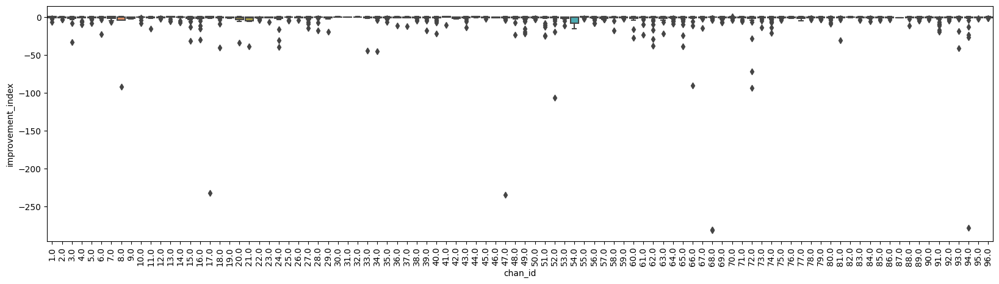

In [ ]:
# let bot plot the improvement distribution for each single chan, unit pair
# let's plot the scatter plot
row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') &\
    (all_recon_exp_results_df['score_mods'] == 'MSE')
fig, ax = plt.subplots(1, 1, figsize=(20, 5))
sns.boxplot(data=all_recon_exp_results_df[row_filter], x='chan_id', y='improvement_index', ax=ax)
# rotate the x labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

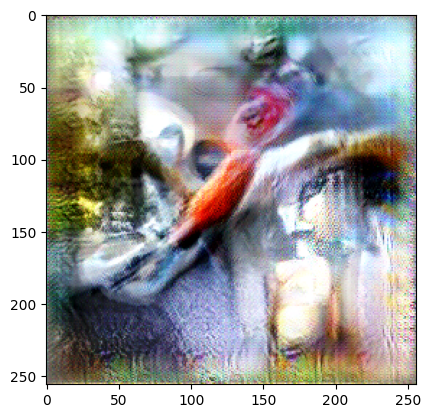

In [ ]:
proto = proto_and_mask_info[proto_and_mask_info['chan_id'] == 40]
proto = proto['proto_img_torch'].iloc[0]
plt.imshow(ToPILImage()(proto))

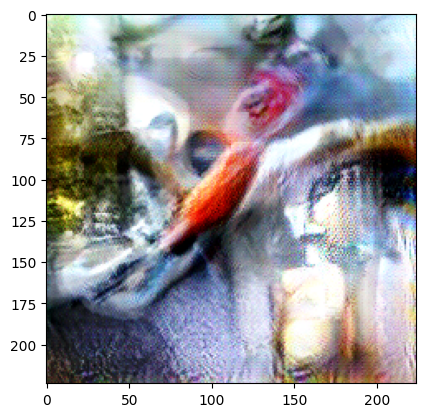

In [ ]:
# let print proportion of chan 22

from PIL import Image
from torchvision import transforms
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])

proto = preprocess(ToPILImage()(proto))
plt.imshow(ToPILImage()(proto))


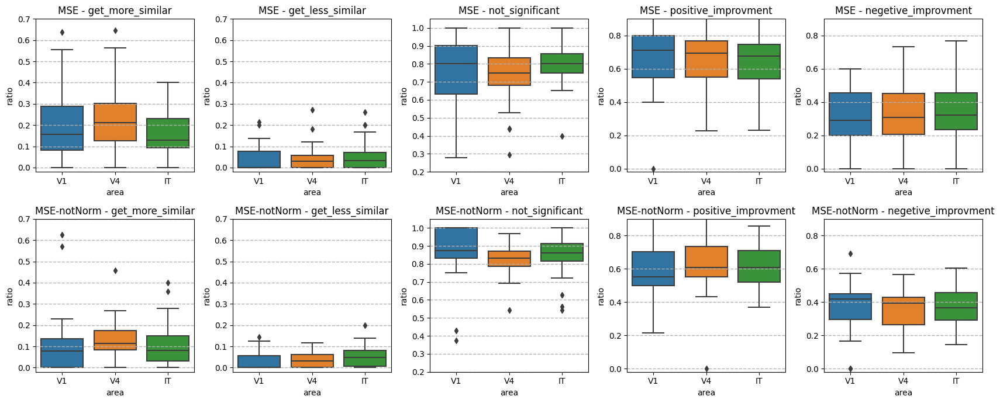

In [ ]:
# for aread of each expriment-thread let find the percentage of the sucsessful improvement, unsucsessful and not significant, and save the result in a pd
area_improvement = pd.DataFrame(columns=['area', 'get_more_similar', 'get_less_similar', 'not_significant',\
     'total', 'exp_name', 'thread_id', 'sampling_mods', 'score_mods', 'positive_improvment', 'negetive_improvment'])

all_unigue_exp = all_recon_exp_results_df['exp_name'].unique()
max_num_of_thread = all_recon_exp_results_df['iThread'].max()+1
area_list = ['V1', 'V4', 'IT']

for exp_name in all_unigue_exp:
    for iThread in range(max_num_of_thread):
        sub_pd = all_recon_exp_results_df[(all_recon_exp_results_df['exp_name'] == exp_name) & (all_recon_exp_results_df['iThread'] == iThread)]
        # check if the sub_pd is not empty
        if sub_pd.shape[0] > 0:
            for area in area_list:
                sub_pd_area = sub_pd[sub_pd['area'] == area]
                total = sub_pd_area.shape[0]
                if total > 0:
                    sucsessful = sub_pd_area[sub_pd_area['improvement'] == 1].shape[0]
                    unsucsessful = sub_pd_area[sub_pd_area['improvement'] == -1].shape[0]
                    not_significant = sub_pd_area[sub_pd_area['improvement'] == 0].shape[0]
                    positive_improvment = sub_pd_area[sub_pd_area['slope_vec'] > 0].shape[0]
                    negetive_improvment = sub_pd_area[sub_pd_area['slope_vec'] <= 0].shape[0]
                    area_improvement.loc[len(area_improvement)] = [area, sucsessful/total, unsucsessful/total, not_significant/total, total, exp_name, iThread, sub_pd['sampling_mods'].unique()[0], sub_pd['score_mods'].unique()[0],\
                                                                    positive_improvment/total, negetive_improvment/total]
                else:
                    area_improvement.loc[len(area_improvement)] = [area, np.nan, np.nan, np.nan, 0, exp_name, iThread, sub_pd['sampling_mods'].unique()[0], sub_pd['score_mods'].unique()[0], np.nan, np.nan]

# let plot ration of sucsessful, unsucsessful and not significant improvement for each area in box plot for 'sampling_mods' = 'all' and both 'score_mods'
# so we need a 3*2 grid of box plots
    ax_lim = [[-.02, .7], [-.02, .7], [.2, 1.05], [-.02, .9], [-.02, .9]]
fig, ax = plt.subplots(2, 5, figsize=(17, 7))    
for i, cond in enumerate(['get_more_similar', 'get_less_similar', 'not_significant', 'positive_improvment', 'negetive_improvment']):
    for j, score_mod in enumerate(['MSE', 'MSE-notNorm']):
        ax[j, i].grid(True, linestyle='--', linewidth=1)
        row_filter = (area_improvement['sampling_mods'] == 'all') &\
            (area_improvement['score_mods'] == score_mod) &\
            (area_improvement['total'] > 0)
        sns.boxplot(data=area_improvement[row_filter], x='area', y=cond, ax=ax[j, i])
        ax[j, i].set_title(f'{score_mod} - {cond}')
        ax[j, i].set_ylim(ax_lim[i])
        ax[j, i].set_ylabel('ratio')
plt.tight_layout()

In [ ]:

def get_lreg(x, y):
    clean_data_x, clean_data_y = clean_data(x, y)
    slope, intercept, r_value, p_value, std_err = stats.linregress(clean_data_x, clean_data_y)
    return slope, intercept, p_value, r_value


# The sucsessful in reconstraction can be capture how much linear regression betwenn target_resp and last_gen_resp explain the variance compare to the linear regression between target_resp and first_gen_resp
# let find the r2 between the target_resp and last_gen_resp and first_gen_resp and save the result in a pd for each [exp_name, thread_id] for each area and all area
# let add targer iamge and recon image and init image to the pd as well
recon_sucsessful_r2 = pd.DataFrame(columns=['area', 'r2_last_gen', 'r2_first_gen', 'slope_last_gen', 'slope_first_gen',
                                            'pValue_last_gen', 'pValue_first_gen', 'exp_name', 'thread_id', 'sampling_mods', 'score_mods',
                                            'target_img', 'recon_img', 'init_img', 'img_size', 'img_poss', 'iThread'])
area_list = ['all', 'V1', 'V4', 'IT']

all_unigue_exp = all_recon_exp_results_df['exp_name'].unique()
max_num_of_thread = all_recon_exp_results_df['iThread'].max()+1

for exp_name in all_unigue_exp:
    for iThread in range(max_num_of_thread):
        sub_pd = all_recon_exp_results_df[(all_recon_exp_results_df['exp_name'] == exp_name) &\
                                           (all_recon_exp_results_df['iThread'] == iThread)]
        # check if the sub_pd is not empty
        if sub_pd.shape[0] > 0:
            for area in area_list:
                if area == 'all':
                    sub_pd_area = sub_pd
                    exp_name = sub_pd['exp_name'].unique()[0]
                    iThread = int(sub_pd['iThread'].unique()[0])
                    exp_id = int(sub_pd['exp_id'].iloc[0])
                    exp_file = f'{exp_name}_expId{exp_id:03d}.mat'
                    recon_exp_data = mat73.loadmat(os.path.join(recon_exp_path, exp_file))
                    nThread = int(recon_exp_data['num_of_thread'])

                    if nThread > 1:
                        target_img_uint8 = recon_exp_data['target_imgs_cell'][iThread][0]
                        recon_img_uint8 = recon_exp_data['recon_img_cell'][iThread][0]
                        init_img_uint8 = recon_exp_data['init_img_cell'][iThread][0]
                        img_size = recon_exp_data['img_size'][iThread][0]
                        img_poss = recon_exp_data['img_poss'][iThread][0]
                        sampling_mode = recon_exp_data['sampling_mods'][iThread][0]

                    else:
                        target_img_uint8 = recon_exp_data['target_imgs_cell'][iThread]
                        recon_img_uint8 = recon_exp_data['recon_img_cell'][iThread]
                        init_img_uint8 = recon_exp_data['init_img_cell'][iThread]
                        img_size = recon_exp_data['img_size'][iThread]
                        img_poss = recon_exp_data['img_poss'][iThread]
                        sampling_mode = recon_exp_data['sampling_mods'][iThread]
                    init_img = uint8_image_to_pytorch(init_img_uint8)
                    target_img = uint8_image_to_pytorch(target_img_uint8)
                    recon_img = uint8_image_to_pytorch(recon_img_uint8)
                                        
                else:
                    sub_pd_area = sub_pd[sub_pd['area'] == area]
                    init_img = np.nan
                    target_img = np.nan
                    recon_img = np.nan

                total = sub_pd_area.shape[0]
                if total > 0:
                    slope_last_gen, intercept_last_gen, pValue_last_gen, r2_last_gen = get_lreg(sub_pd_area['resp_to_target'].values, sub_pd_area['last_gen_resp'].values)
                    slope_first_gen, intercept_first_gen, pValue_first_gen, r2_first_gen = get_lreg(sub_pd_area['resp_to_target'].values, sub_pd_area['first_gen_resp'].values)
                    recon_sucsessful_r2.loc[len(recon_sucsessful_r2)] = \
                        [area, r2_last_gen, r2_first_gen, slope_last_gen, slope_first_gen, pValue_last_gen, pValue_first_gen,\
                        exp_name, iThread, sub_pd['sampling_mods'].unique()[0], sub_pd['score_mods'].unique()[0],\
                        target_img, recon_img, init_img, sub_pd['img_size'].iloc[0], sub_pd['img_poss'].iloc[0], sub_pd['iThread'].iloc[0]]
                        
                else:
                    recon_sucsessful_r2.loc[len(recon_sucsessful_r2)] = [area, np.nan, np.nan, np.nan, np.nan, np.nan, np.nan, \
                                                                         exp_name, iThread, sub_pd['sampling_mods'].unique()[0], sub_pd['score_mods'].unique()[0],\
                                                                         np.nan, np.nan, np.nan, np.nan, np.nan, np.nan]
                    

c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\scipy\stats\_stats_mstats_common.py:199: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / 

Nume of expriments with MSE and all responce: 4
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\1594402554.py:28: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\1594402554.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\1594402554.py:30: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_init_img_tensor = torch.stack([

Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\Alireza\miniconda3\envs\cosine-project\lib\site-packages\lpips\weights\v0.1\alex.pth
Correlation between r2_improvement and similarity_index_lpips: r=0.31, p=0.69


C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\1594402554.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_recon_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_recon_img_lpips_sorted])
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\1594402554.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_target_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_target_img_lpips_sorted])
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\1594402554.py:46: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(

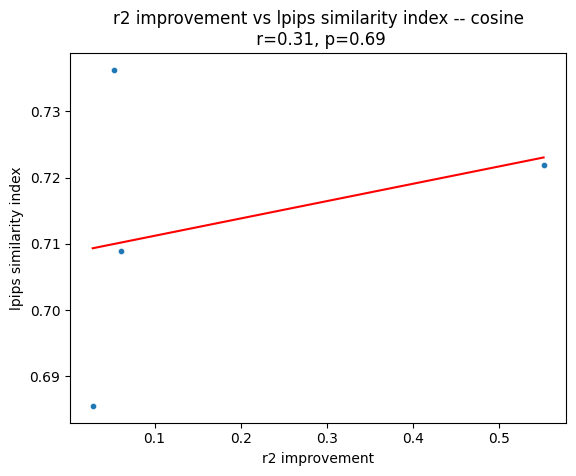

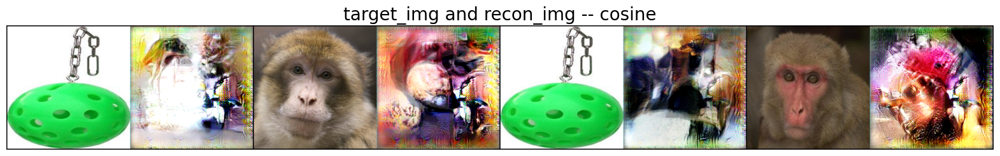

In [ ]:
# let print target and recon image for each expriment
mode = 'MSE'
row_filter = (recon_sucsessful_r2['sampling_mods'] == 'all') &\
            (recon_sucsessful_r2['score_mods'] == mode) &\
            (recon_sucsessful_r2['area'] == 'all')
print(f'Nume of expriments with MSE and all responce: {sum(row_filter)}')

all_recon_img = recon_sucsessful_r2[row_filter]['recon_img'].values
all_target_img = recon_sucsessful_r2[row_filter]['target_img'].values
all_init_img = recon_sucsessful_r2[row_filter]['init_img'].values
r2_improvement = recon_sucsessful_r2[row_filter]['r2_last_gen'].values - recon_sucsessful_r2[row_filter]['r2_first_gen'].values

# let sort the images based on the r2_improvement and desending order
sorted_index = np.argsort(r2_improvement)[::-1]
all_recon_img = all_recon_img[sorted_index]
all_target_img = all_target_img[sorted_index]
all_init_img = all_init_img[sorted_index]
r2_improvement = r2_improvement[sorted_index]
# let find imgage in target_img that is C<3
target_img_C_less_3 = []
for i in range(len(all_target_img)):
    if all_target_img[i].shape[0] < 3:
        # let make it 3D by repeating the first channel
        all_target_img[i] = all_target_img[i].repeat(3, 1, 1)
        

# Convert numpy arrays to PyTorch tensors before stacking
all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
all_init_img_tensor = torch.stack([torch.tensor(img) for img in all_init_img])

# let get the lpips similarity between the target and recon image
similarity_lpips_recon = compute_lpips_similarity_index(all_target_img_tensor, all_recon_img_tensor, net_type='alex').squeeze().detach().cpu().numpy()
similarity_lpips_init = compute_lpips_similarity_index(all_target_img_tensor, all_init_img_tensor, net_type='alex').squeeze().detach().cpu().numpy()

#similarity_index_lpips = (similarity_lpips_recon - similarity_lpips_init)/(similarity_lpips_recon)

# sort the images also based on the similarity_index_recon and desending order
sorted_index = np.argsort(similarity_lpips_recon)[::-1]
all_recon_img_lpips_sorted = all_recon_img[sorted_index]
all_target_img_lpips_sorted = all_target_img[sorted_index]
all_init_img_lpips_sorted = all_init_img[sorted_index]
# let convert the list to tensor
all_recon_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_recon_img_lpips_sorted])
all_target_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_target_img_lpips_sorted])
all_init_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_init_img_lpips_sorted])

# let find the correlation between the r2_improvement and similarity_index_lpips
x1 = r2_improvement  # Ensure it's a numpy array
y1 = similarity_lpips_recon  # Ensure it's a numpy array
# let plot the scatter plot
fig, ax = plt.subplots()
sns.scatterplot(x=x1, y=y1, ax=ax, s=20)
ax.set_xlabel('r2 improvement')
ax.set_ylabel('lpips similarity index')
# let found the correlation between the r2_improvement and similarity_index_lpips
r, p = stats.pearsonr(x1, y1)
print(f'Correlation between r2_improvement and similarity_index_lpips: r={r:.2f}, p={p:.2f}')
# let fit a linear regression line and get p val and eplain the variance
slope, intercept, r_value, p_value, std_err = stats.linregress(x1, y1)
x = np.array([x1.min(), x1.max()])
y = slope * x + intercept
ax.plot(x, y, color='r')
ax.set_title(f'r2 improvement vs lpips similarity index -- {mode}\n r={r:.2f}, p={p:.2f}')

# let print the recon iamge side by side with the target image (concat two images tensor) in 7*7 grid 
# let concat the image tensor
from torchvision.utils import make_grid

concat_imgs = torch.cat([all_target_img_tensor, all_recon_img_tensor], dim=3)
# let make the grid
grid_img = make_grid(concat_imgs, nrow=7).cpu()
# let plot the grid_img
plt.figure(figsize=(20, 15))
plt.imshow(ToPILImage()(grid_img))
plt.title(f'target_img and recon_img -- {mode}', fontsize=20)
plt.axis('off')

%red_line = torch.ones([all_target_img_lpips_sorted_tensor.shape[0], all_target_img_lpips_sorted_tensor.shape[1], all_target_img_lpips_sorted_tensor.shape[2], 3])
concat_imgs_lpips_sorted = torch.cat([all_target_img_lpips_sorted_tensor, red_line, all_recon_img_lpips_sorted_tensor], dim=3)
# let make the grid
grid_img_lpips_sorted = make_grid(concat_imgs_lpips_sorted, nrow=7).cpu()
# let plot the grid_img
plt.figure(figsize=(20, 15))
plt.imshow(ToPILImage()(grid_img_lpips_sorted))


Nume of expriments with MSE and all responce: 4


C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\2662883713.py:36: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\2662883713.py:37: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1924\2662883713.py:38: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_init_img_tensor = torch.stack([

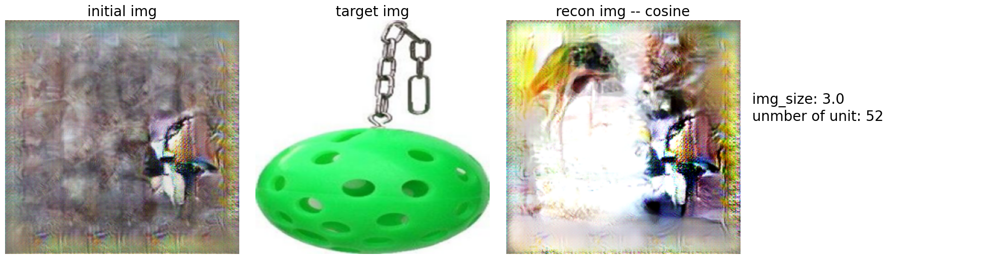

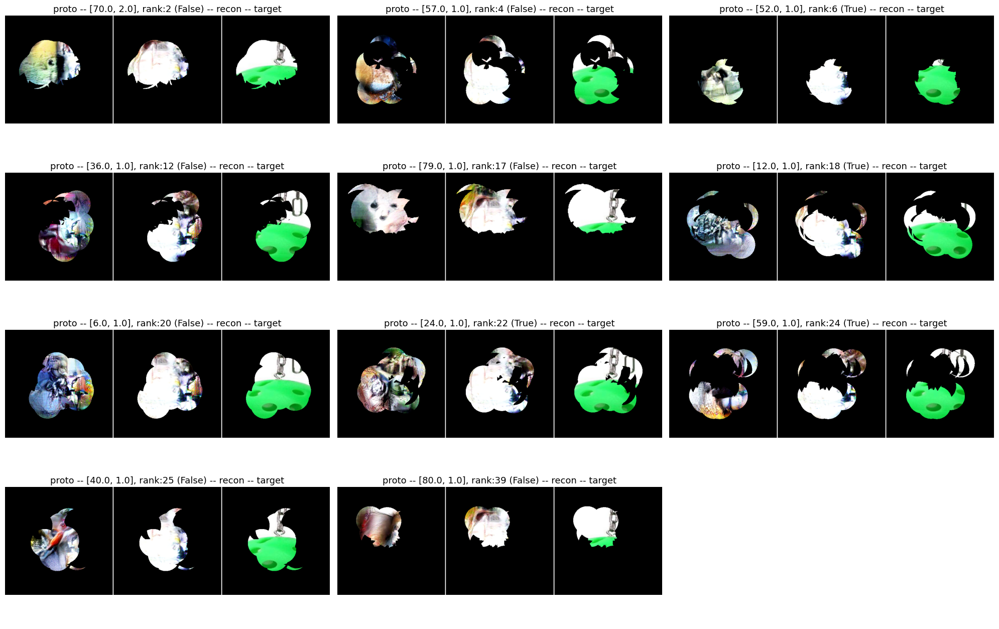

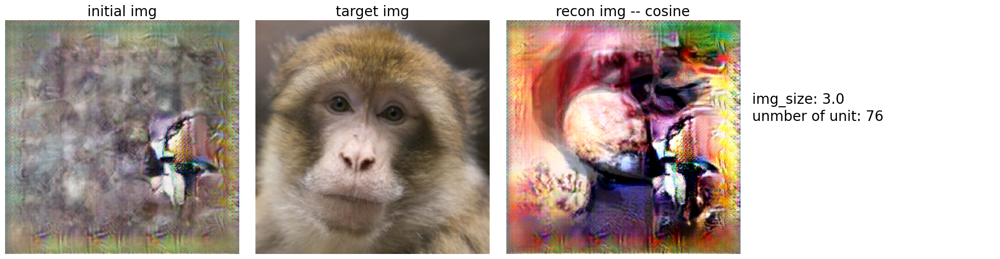

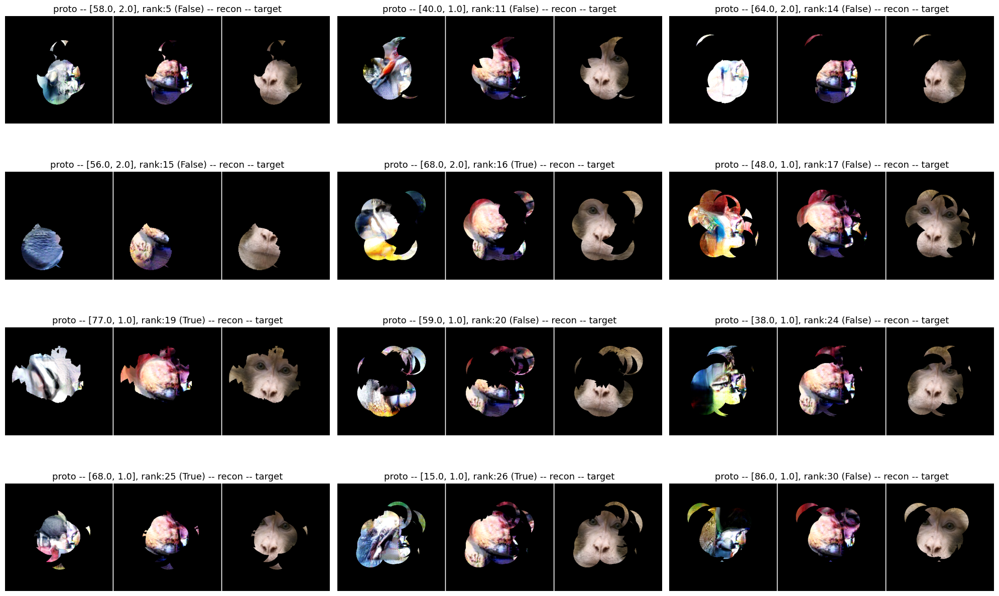

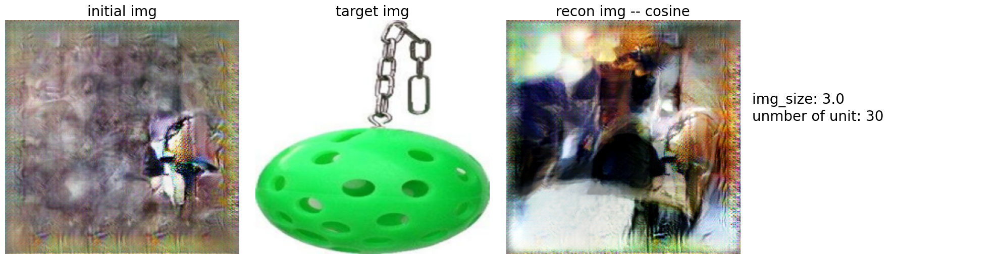

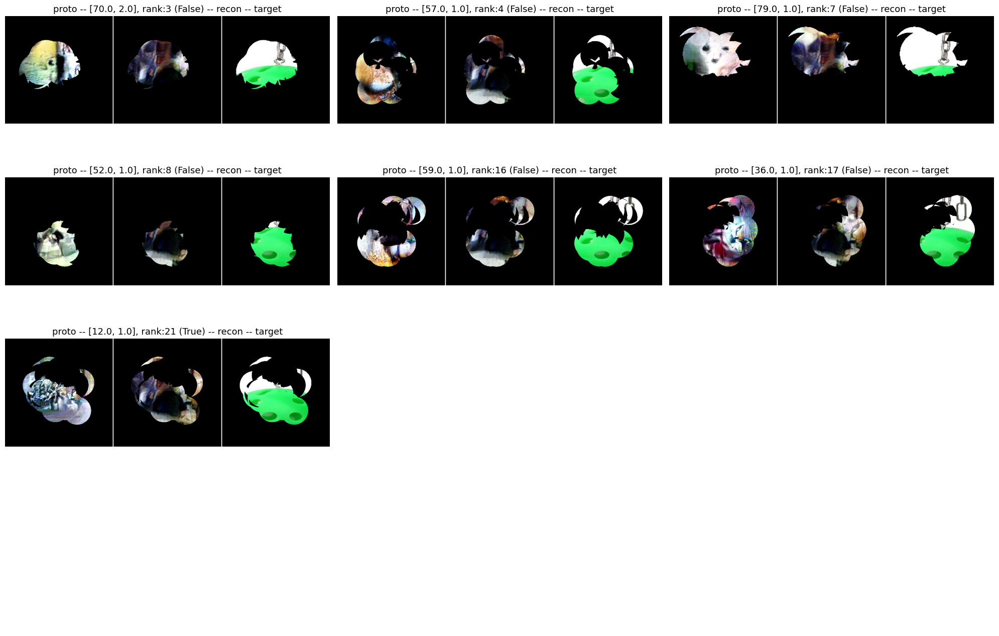

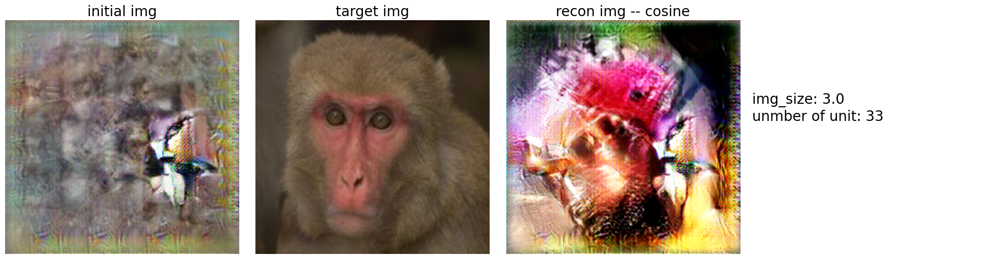

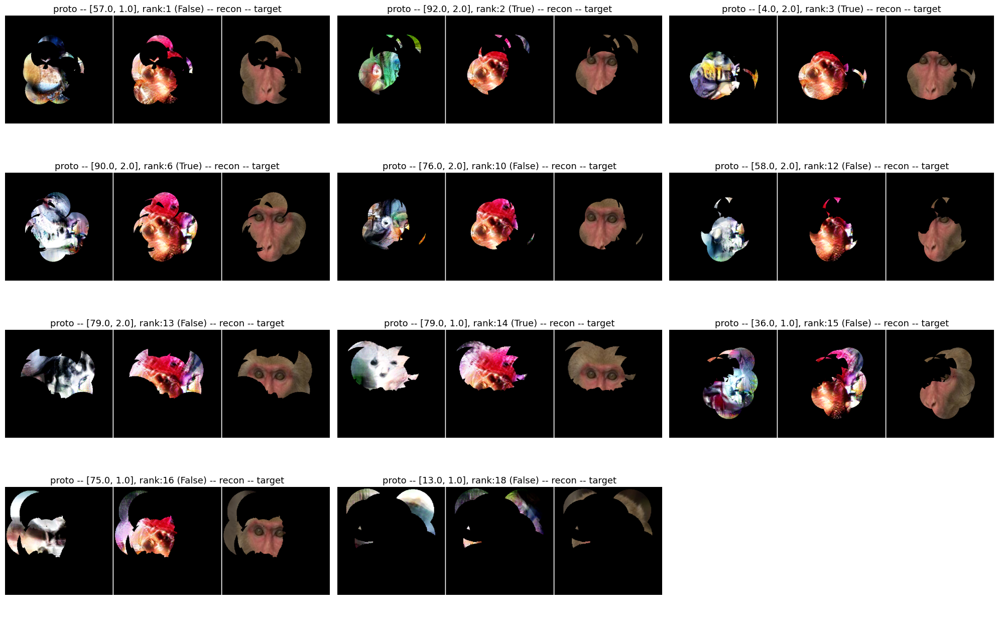

In [ ]:
# let for all expriment print the target and recon image and the recon plus masked proto for the 10 of unit wiht best improvement
pixels_per_deg = 128
for mode in ['cosine']: #['MSE', 'MSE-notNorm']:
    save_path = os.path.join(data_root, rf"result\patch_rcon_vs_proto_{mode}_improvement_index")
    os.makedirs(save_path, exist_ok=True)
    alpha = .05
    row_filter = (recon_sucsessful_r2['sampling_mods'] == 'all') &\
                (recon_sucsessful_r2['score_mods'] == mode) &\
                (recon_sucsessful_r2['area'] == 'all')
    print(f'Nume of expriments with MSE and all responce: {sum(row_filter)}')

    all_recon_img = recon_sucsessful_r2[row_filter]['recon_img'].values
    all_target_img = recon_sucsessful_r2[row_filter]['target_img'].values
    all_init_img = recon_sucsessful_r2[row_filter]['init_img'].values
    all_exp_name = recon_sucsessful_r2[row_filter]['exp_name'].values
    all_exp_thread_id = recon_sucsessful_r2[row_filter]['thread_id'].values
    r2_improvement = recon_sucsessful_r2[row_filter]['r2_last_gen'].values - recon_sucsessful_r2[row_filter]['r2_first_gen'].values

    # let sort the images based on the r2_improvement and desending order
    sorted_index = np.argsort(r2_improvement)[::-1]
    all_recon_img = all_recon_img[sorted_index]
    all_target_img = all_target_img[sorted_index]
    all_init_img = all_init_img[sorted_index]
    all_exp_name = all_exp_name[sorted_index]
    all_exp_thread_id = all_exp_thread_id[sorted_index]
    r2_improvement = r2_improvement[sorted_index]
    # let find imgage in target_img that is C<3
    target_img_C_less_3 = []
    for i in range(len(all_target_img)):
        if all_target_img[i].shape[0] < 3:
            # let make it 3D by repeating the first channel
            all_target_img[i] = all_target_img[i].repeat(3, 1, 1)
            

    # Convert numpy arrays to PyTorch tensors before stacking
    all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
    all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
    all_init_img_tensor = torch.stack([torch.tensor(img) for img in all_init_img])

    i = 1
    for i in range(len(all_exp_name)):
        exp_name = all_exp_name[i]
        thread_id = all_exp_thread_id[i]

        sub_result_df = all_recon_exp_results_df[(all_recon_exp_results_df['exp_name'] == exp_name) & (all_recon_exp_results_df['iThread'] == thread_id)]
        img_size = sub_result_df['img_size'].iloc[0]
        target_img = all_target_img_tensor[i]
        recon_img = all_recon_img_tensor[i]
        init_img = all_init_img_tensor[i]

        real_pos_proto_img_list = [get_real_pos_img_torch(proto_and_mask_info['proto_img_torch'].iloc[i], proto_and_mask_info['proto_pos'].iloc[i], 
                                                    proto_and_mask_info['proto_size'].iloc[i], screen_size=img_size, grayness_level=0, pixels_per_deg=128)\
                                                    for i in range(len(proto_and_mask_info))]
        real_pos_mask_list = [get_real_pos_img_torch(torch.from_numpy(proto_and_mask_info['proto_mask_lin'].iloc[i]), proto_and_mask_info['proto_pos'].iloc[i],
                                            proto_and_mask_info['proto_size'].iloc[i], screen_size=img_size, grayness_level=0, pixels_per_deg=128)\
                                                    for i in range(len(proto_and_mask_info))]
        real_pos_bin_mask_list = [make_binary_mask_torch(mask) for mask in real_pos_mask_list]
        proto_chan_id = [proto_and_mask_info['chan_id'].iloc[i] for i in range(len(proto_and_mask_info))]
        proto_unit_id = [proto_and_mask_info['unit_id'].iloc[i] for i in range(len(proto_and_mask_info))]
        # let's convert the list to tensor


        img_size_pixels = int(img_size * pixels_per_deg)
        target_img = F.resize(target_img, [img_size_pixels, img_size_pixels])
        recon_img = F.resize(recon_img, [img_size_pixels, img_size_pixels])
        init_img = F.resize(init_img, [img_size_pixels, img_size_pixels])

        # let find then [chan, unit] with the best improvement and which have proto_img (i.e., lpips_similarity_mean_target is not nan)
        sorted_index = np.argsort(sub_result_df['improvement_index'].values)[::-1]
        sorted_unit_improvement = sub_result_df['improvement_index'].values[sorted_index]
        sig_test_flag = sub_result_df['pValue_vec'].values[sorted_index] < alpha
        sorted_unit_chan_id = sub_result_df['chan_id'].values[sorted_index]
        sorted_unit_unit_id = sub_result_df['unit_id'].values[sorted_index]
        lpips_sorted = sub_result_df['lpips_similarity_mean_target'].values[sorted_index]

        # let have fun and plot
        fig, ax = plt.subplots(1,4, figsize=(20, 5))
        # first row init image, target image, recon image
        ax[0].imshow(ToPILImage()(init_img))
        ax[0].set_title('initial img', fontsize=20)
        ax[0].axis('off')

        ax[1].imshow(ToPILImage()(target_img))
        ax[1].set_title('target img', fontsize=20)
        ax[1].axis('off')

        ax[2].imshow(ToPILImage()(recon_img))
        ax[2].set_title(f'recon img -- {mode}', fontsize=20)
        ax[2].axis('off')
        # print sum text in the last image
        text = f'img_size: {img_size}\n'
        text += f'unmber of unit: {len(sorted_unit_improvement)}\n'
        # let print the text
        ax[3].text(0, .5, text, fontsize=20)
        ax[3].axis('off')

        plt.tight_layout()
        plt.show()
        fig.savefig(os.path.join(save_path, f'{i}_{exp_name}_thread_{thread_id}_recon_info.png'),  dpi=300, bbox_inches='tight')


        fig, ax = plt.subplots(4, 3, figsize=(20, 13))
        ax_indexing = [(i, j) for i in range(4) for j in range(3)]
        # let for each unit print the proto_img and the recon_img masked with proto mask. if it exist
        c = 0
        for k in range(len(sorted_unit_improvement)):
            if c >= len(ax_indexing):
                break
            ii, jj = ax_indexing[c]
            if np.isnan(lpips_sorted[k]) | (sorted_unit_improvement[k] < 0):
                continue
            # let find the index of the proto_chan_id and proto_unit_id
            chan_id_here = sorted_unit_chan_id[k]
            unit_id_here = sorted_unit_unit_id[k]
            proto_index = (proto_chan_id == chan_id_here) & (proto_unit_id == unit_id_here)
            # fing the index of the proto_index
            proto_index = int(np.where(proto_index)[0][0])
            proto_img = real_pos_proto_img_list[proto_index]
            proto_mask = real_pos_bin_mask_list[proto_index]

            proto_img_masked = apply_mask_to_image_torch(proto_img, proto_mask).squeeze()
            recon_img_masked = apply_mask_to_image_torch(recon_img, proto_mask).squeeze()
            targer_img_masked = apply_mask_to_image_torch(target_img, proto_mask).squeeze()

            # concat the proto_img_masked and recon_img_masked with a red line in the middle
            red_line = torch.ones([proto_img_masked.shape[0], proto_img_masked.shape[1], 3])
            proto_img_masked = torch.cat([proto_img_masked, red_line, recon_img_masked, red_line, targer_img_masked], dim=2)
            ax[ii, jj].imshow(ToPILImage()(proto_img_masked))
            ax[ii, jj].set_title(f'proto -- [{chan_id_here}, {unit_id_here}], rank:{k+1} ({sig_test_flag[k]}) -- recon -- target', fontsize=13)
            ax[ii, jj].axis('off')
            c = c + 1
        while c < len(ax_indexing):
            ii, jj = ax_indexing[c]
            ax[ii, jj].axis('off')
            c = c + 1
            
        plt.tight_layout()
        plt.show()
        fig.savefig(os.path.join(save_path, f'{i}_{exp_name}_thread_{thread_id}_recon_vs_proto.png'),  dpi=300, bbox_inches='tight')

        # close all figures
        plt.close()



In [ ]:
# [just diffrent masking] let for all expriment print the target and recon image and the recon plus masked proto for the 10 of unit wiht best improvement
"""for mode in ['MSE', 'MSE-notNorm']:
    save_path = os.path.join(data_root, rf"result\patch_rcon_vs_proto_{mode}_exp_mask")
    os.makedirs(save_path, exist_ok=True)
    alpha = .05
    row_filter = (recon_sucsessful_r2['sampling_mods'] == 'all') &\
                (recon_sucsessful_r2['score_mods'] == mode) &\
                (recon_sucsessful_r2['area'] == 'all')
    print(f'Nume of expriments with MSE and all responce: {sum(row_filter)}')

    all_recon_img = recon_sucsessful_r2[row_filter]['recon_img'].values
    all_target_img = recon_sucsessful_r2[row_filter]['target_img'].values
    all_init_img = recon_sucsessful_r2[row_filter]['init_img'].values
    all_exp_name = recon_sucsessful_r2[row_filter]['exp_name'].values
    all_exp_thread_id = recon_sucsessful_r2[row_filter]['thread_id'].values
    r2_improvement = recon_sucsessful_r2[row_filter]['r2_last_gen'].values - recon_sucsessful_r2[row_filter]['r2_first_gen'].values

    # let sort the images based on the r2_improvement and desending order
    sorted_index = np.argsort(r2_improvement)[::-1]
    all_recon_img = all_recon_img[sorted_index]
    all_target_img = all_target_img[sorted_index]
    all_init_img = all_init_img[sorted_index]
    all_exp_name = all_exp_name[sorted_index]
    all_exp_thread_id = all_exp_thread_id[sorted_index]
    r2_improvement = r2_improvement[sorted_index]
    # let find imgage in target_img that is C<3
    target_img_C_less_3 = []
    for i in range(len(all_target_img)):
        if all_target_img[i].shape[0] < 3:
            # let make it 3D by repeating the first channel
            all_target_img[i] = all_target_img[i].repeat(3, 1, 1)
            

    # Convert numpy arrays to PyTorch tensors before stacking
    all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
    all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
    all_init_img_tensor = torch.stack([torch.tensor(img) for img in all_init_img])

    i = 1
    for i in range(len(all_exp_name)):
        exp_name = all_exp_name[i]
        thread_id = all_exp_thread_id[i]

        sub_result_df = all_recon_exp_results_df[(all_recon_exp_results_df['exp_name'] == exp_name) & (all_recon_exp_results_df['iThread'] == thread_id)]
        img_size = sub_result_df['img_size'].iloc[0]
        target_img = all_target_img_tensor[i]
        recon_img = all_recon_img_tensor[i]
        init_img = all_init_img_tensor[i]

        real_pos_proto_img_list = [get_real_pos_img_torch(proto_and_mask_info['proto_img_torch'].iloc[i], proto_and_mask_info['proto_pos'].iloc[i], 
                                                    proto_and_mask_info['proto_size'].iloc[i], screen_size=img_size, grayness_level=0, pixels_per_deg=128)\
                                                    for i in range(len(proto_and_mask_info))]
        real_pos_mask_list = [get_real_pos_img_torch(torch.from_numpy(proto_and_mask_info['proto_mask_exp'].iloc[i]), proto_and_mask_info['proto_pos'].iloc[i],
                                            proto_and_mask_info['proto_size'].iloc[i], screen_size=img_size, grayness_level=0, pixels_per_deg=128)\
                                                    for i in range(len(proto_and_mask_info))]
        real_pos_bin_mask_list = [make_binary_mask_torch(mask) for mask in real_pos_mask_list]
        proto_chan_id = [proto_and_mask_info['chan_id'].iloc[i] for i in range(len(proto_and_mask_info))]
        proto_unit_id = [proto_and_mask_info['unit_id'].iloc[i] for i in range(len(proto_and_mask_info))]
        # let's convert the list to tensor


        img_size_pixels = int(img_size * pixels_per_deg)
        target_img = F.resize(target_img, [img_size_pixels, img_size_pixels])
        recon_img = F.resize(recon_img, [img_size_pixels, img_size_pixels])
        init_img = F.resize(init_img, [img_size_pixels, img_size_pixels])

        # let find then [chan, unit] with the best improvement and which have proto_img (i.e., lpips_similarity_mean_target is not nan)
        sorted_index = np.argsort(sub_result_df['this_exp_thread_results'].values)[::-1]
        sorted_unit_improvement = sub_result_df['this_exp_thread_results'].values[sorted_index]
        sig_test_flag = sub_result_df['pValue_vec'].values[sorted_index] < alpha
        sorted_unit_chan_id = sub_result_df['chan_id'].values[sorted_index]
        sorted_unit_unit_id = sub_result_df['unit_id'].values[sorted_index]
        lpips_sorted = sub_result_df['lpips_similarity_mean_target'].values[sorted_index]

        # let have fun and plot
        fig, ax = plt.subplots(1,4, figsize=(20, 5))
        # first row init image, target image, recon image
        ax[0].imshow(ToPILImage()(init_img))
        ax[0].set_title('initial img', fontsize=20)
        ax[0].axis('off')

        ax[1].imshow(ToPILImage()(target_img))
        ax[1].set_title('target img', fontsize=20)
        ax[1].axis('off')

        ax[2].imshow(ToPILImage()(recon_img))
        ax[2].set_title(f'recon img -- {mode}', fontsize=20)
        ax[2].axis('off')
        # print sum text in the last image
        text = f'img_size: {img_size}\n'
        text += f'unmber of unit: {len(sorted_unit_improvement)}\n'
        # let print the text
        ax[3].text(0, .5, text, fontsize=20)
        ax[3].axis('off')

        plt.tight_layout()
        plt.show()
        fig.savefig(os.path.join(save_path, f'{i}_{exp_name}_thread_{thread_id}_recon_info.png'),  dpi=300, bbox_inches='tight')


        fig, ax = plt.subplots(4, 3, figsize=(20, 13))
        ax_indexing = [(i, j) for i in range(4) for j in range(3)]
        # let for each unit print the proto_img and the recon_img masked with proto mask. if it exist
        c = 0
        for k in range(len(sorted_unit_improvement)):
            if c >= len(ax_indexing):
                break
            ii, jj = ax_indexing[c]
            if np.isnan(lpips_sorted[k]) | (sorted_unit_improvement[k] < 0):
                continue
            # let find the index of the proto_chan_id and proto_unit_id
            chan_id_here = sorted_unit_chan_id[k]
            unit_id_here = sorted_unit_unit_id[k]
            proto_index = (proto_chan_id == chan_id_here) & (proto_unit_id == unit_id_here)
            # fing the index of the proto_index
            proto_index = int(np.where(proto_index)[0][0])
            proto_img = real_pos_proto_img_list[proto_index]
            proto_mask = real_pos_mask_list[proto_index]

            proto_img_masked = apply_mask_to_image_torch(proto_img, proto_mask).squeeze()
            recon_img_masked = apply_mask_to_image_torch(recon_img, proto_mask).squeeze()
            targer_img_masked = apply_mask_to_image_torch(target_img, proto_mask).squeeze()

            # concat the proto_img_masked and recon_img_masked with a red line in the middle
            red_line = torch.ones([proto_img_masked.shape[0], proto_img_masked.shape[1], 3])
            proto_img_masked = torch.cat([proto_img_masked, red_line, recon_img_masked, red_line, targer_img_masked], dim=2)
            ax[ii, jj].imshow(ToPILImage()(proto_img_masked))
            ax[ii, jj].set_title(f'proto -- [{chan_id_here}, {unit_id_here}], rank:{k+1} ({sig_test_flag[k]}) -- recon -- target', fontsize=13)
            ax[ii, jj].axis('off')
            c = c + 1
        while c < len(ax_indexing):
            ii, jj = ax_indexing[c]
            ax[ii, jj].axis('off')
            c = c + 1
            
        plt.tight_layout()
        plt.show()
        fig.savefig(os.path.join(save_path, f'{i}_{exp_name}_thread_{thread_id}_recon_vs_proto.png'),  dpi=300, bbox_inches='tight')

        # close all figures
        plt.close()"""



In [ ]:
# let print target and recon image for each expriment
mode = 'MSE-notNorm'
row_filter = (recon_sucsessful_r2['sampling_mods'] == 'all') &\
            (recon_sucsessful_r2['score_mods'] == mode) &\
            (recon_sucsessful_r2['area'] == 'all')
print(f'Nume of expriments with MSE and all responce: {sum(row_filter)}')

all_recon_img = recon_sucsessful_r2[row_filter]['recon_img'].values
all_target_img = recon_sucsessful_r2[row_filter]['target_img'].values
all_init_img = recon_sucsessful_r2[row_filter]['init_img'].values
r2_improvement = recon_sucsessful_r2[row_filter]['r2_last_gen'].values - recon_sucsessful_r2[row_filter]['r2_first_gen'].values

# let sort the images based on the r2_improvement and desending order
sorted_index = np.argsort(r2_improvement)[::-1]
all_recon_img = all_recon_img[sorted_index]
all_target_img = all_target_img[sorted_index]
all_init_img = all_init_img[sorted_index]
r2_improvement = r2_improvement[sorted_index]
# let find imgage in target_img that is C<3
target_img_C_less_3 = []
for i in range(len(all_target_img)):
    if all_target_img[i].shape[0] < 3:
        # let make it 3D by repeating the first channel
        all_target_img[i] = all_target_img[i].repeat(3, 1, 1)
        

# Convert numpy arrays to PyTorch tensors before stacking
all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
all_init_img_tensor = torch.stack([torch.tensor(img) for img in all_init_img])

# let get the lpips similarity between the target and recon image
similarity_lpips_recon = compute_lpips_similarity_index(all_target_img_tensor, all_recon_img_tensor, net_type='alex').squeeze().detach().cpu().numpy()
similarity_lpips_init = compute_lpips_similarity_index(all_target_img_tensor, all_init_img_tensor, net_type='alex').squeeze().detach().cpu().numpy()

#similarity_index_lpips = (similarity_lpips_recon - similarity_lpips_init)/(similarity_lpips_recon)

# sort the images also based on the similarity_index_recon and desending order
sorted_index = np.argsort(similarity_lpips_recon)[::-1]
all_recon_img_lpips_sorted = all_recon_img[sorted_index]
all_target_img_lpips_sorted = all_target_img[sorted_index]
all_init_img_lpips_sorted = all_init_img[sorted_index]
# let convert the list to tensor
all_recon_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_recon_img_lpips_sorted])
all_target_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_target_img_lpips_sorted])
all_init_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_init_img_lpips_sorted])

# let find the correlation between the r2_improvement and similarity_index_lpips
x1 = r2_improvement  # Ensure it's a numpy array
y1 = similarity_lpips_recon  # Ensure it's a numpy array
# let plot the scatter plot
fig, ax = plt.subplots()
sns.scatterplot(x=x1, y=y1, ax=ax, s=20)
ax.set_xlabel('r2 improvement')
ax.set_ylabel('lpips similarity index')
# let found the correlation between the r2_improvement and similarity_index_lpips
r, p = stats.pearsonr(x1, y1)
print(f'Correlation between r2_improvement and similarity_index_lpips: r={r:.2f}, p={p:.2f}')
# let fit a linear regression line and get p val and eplain the variance
slope, intercept, r_value, p_value, std_err = stats.linregress(x1, y1)
x = np.array([x1.min(), x1.max()])
y = slope * x + intercept
ax.plot(x, y, color='r')
ax.set_title(f'r2 improvement vs lpips similarity index -- {mode}\n r={r:.2f}, p={p:.2f}')

# let print the recon iamge side by side with the target image (concat two images tensor) in 7*7 grid 
# let concat the image tensor
from torchvision.utils import make_grid

concat_imgs = torch.cat([all_target_img_tensor, all_recon_img_tensor], dim=3)
# let make the grid
grid_img = make_grid(concat_imgs, nrow=7).cpu()
# let plot the grid_img
plt.figure(figsize=(20, 15))
plt.imshow(ToPILImage()(grid_img))
plt.title(f'target_img and recon_img -- {mode}', fontsize=20)
plt.axis('off')


"""concat_imgs_lpips_sorted = torch.cat([all_target_img_lpips_sorted_tensor, all_recon_img_lpips_sorted_tensor], dim=3)
# let make the grid
grid_img_lpips_sorted = make_grid(concat_imgs_lpips_sorted, nrow=7).cpu()
# let plot the grid_img
plt.figure(figsize=(20, 15))
plt.imshow(ToPILImage()(grid_img_lpips_sorted))
"""




In [ ]:
# let print target and recon image for each expriment
mode = 'MSE-notNorm'
row_filter = (recon_sucsessful_r2['sampling_mods'] == 'all') &\
            (recon_sucsessful_r2['score_mods'] == mode) &\
            (recon_sucsessful_r2['area'] == 'all')
print(f'Nume of expriments with MSE and all responce: {sum(row_filter)}')

all_recon_img = recon_sucsessful_r2[row_filter]['recon_img'].values
all_target_img = recon_sucsessful_r2[row_filter]['target_img'].values
all_init_img = recon_sucsessful_r2[row_filter]['init_img'].values
r2_improvement = recon_sucsessful_r2[row_filter]['r2_last_gen'].values - recon_sucsessful_r2[row_filter]['r2_first_gen'].values

# let sort the images based on the r2_improvement and desending order
sorted_index = np.argsort(r2_improvement)[::-1]
all_recon_img = all_recon_img[sorted_index]
all_target_img = all_target_img[sorted_index]
all_init_img = all_init_img[sorted_index]
r2_improvement = r2_improvement[sorted_index]
# let find imgage in target_img that is C<3
target_img_C_less_3 = []
for i in range(len(all_target_img)):
    if all_target_img[i].shape[0] < 3:
        # let make it 3D by repeating the first channel
        all_target_img[i] = all_target_img[i].repeat(3, 1, 1)
        

# Convert numpy arrays to PyTorch tensors before stacking
all_recon_img_tensor = torch.stack([torch.tensor(img) for img in all_recon_img])
all_target_img_tensor = torch.stack([torch.tensor(img) for img in all_target_img])
all_init_img_tensor = torch.stack([torch.tensor(img) for img in all_init_img])

# let get the lpips similarity between the target and recon image
similarity_lpips_recon = compute_lpips_similarity_index(all_target_img_tensor, all_recon_img_tensor, net_type='alex').squeeze().detach().cpu().numpy()
similarity_lpips_init = compute_lpips_similarity_index(all_target_img_tensor, all_init_img_tensor, net_type='alex').squeeze().detach().cpu().numpy()

#similarity_index_lpips = (similarity_lpips_recon - similarity_lpips_init)/(similarity_lpips_recon)

# sort the images also based on the similarity_index_recon and desending order
sorted_index = np.argsort(similarity_lpips_recon)[::-1]
all_recon_img_lpips_sorted = all_recon_img[sorted_index]
all_target_img_lpips_sorted = all_target_img[sorted_index]
all_init_img_lpips_sorted = all_init_img[sorted_index]
# let convert the list to tensor
all_recon_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_recon_img_lpips_sorted])
all_target_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_target_img_lpips_sorted])
all_init_img_lpips_sorted_tensor = torch.stack([torch.tensor(img) for img in all_init_img_lpips_sorted])

# let find the correlation between the r2_improvement and similarity_index_lpips
x1 = r2_improvement  # Ensure it's a numpy array
y1 = similarity_lpips_recon  # Ensure it's a numpy array
# let plot the scatter plot
fig, ax = plt.subplots()
sns.scatterplot(x=x1, y=y1, ax=ax, s=20)
ax.set_xlabel('r2 improvement')
ax.set_ylabel('lpips similarity index')
# let found the correlation between the r2_improvement and similarity_index_lpips
r, p = stats.pearsonr(x1, y1)
print(f'Correlation between r2_improvement and similarity_index_lpips: r={r:.2f}, p={p:.2f}')
# let fit a linear regression line and get p val and eplain the variance
slope, intercept, r_value, p_value, std_err = stats.linregress(x1, y1)
x = np.array([x1.min(), x1.max()])
y = slope * x + intercept
ax.plot(x, y, color='r')
ax.set_title(f'r2 improvement vs lpips similarity index -- {mode}\n r={r:.2f}, p={p:.2f}')

# let print the recon iamge side by side with the target image (concat two images tensor) in 7*7 grid 
# let concat the image tensor
from torchvision.utils import make_grid

concat_imgs = torch.cat([all_target_img_tensor, all_recon_img_tensor], dim=3)
# let make the grid
grid_img = make_grid(concat_imgs, nrow=7).cpu()
# let plot the grid_img
plt.figure(figsize=(20, 15))
plt.imshow(ToPILImage()(grid_img))
plt.title(f'target_img and recon_img -- {mode}', fontsize=20)
plt.axis('off')


"""concat_imgs_lpips_sorted = torch.cat([all_target_img_lpips_sorted_tensor, all_recon_img_lpips_sorted_tensor], dim=3)
# let make the grid
grid_img_lpips_sorted = make_grid(concat_imgs_lpips_sorted, nrow=7).cpu()
# let plot the grid_img
plt.figure(figsize=(20, 15))
plt.imshow(ToPILImage()(grid_img_lpips_sorted))
"""




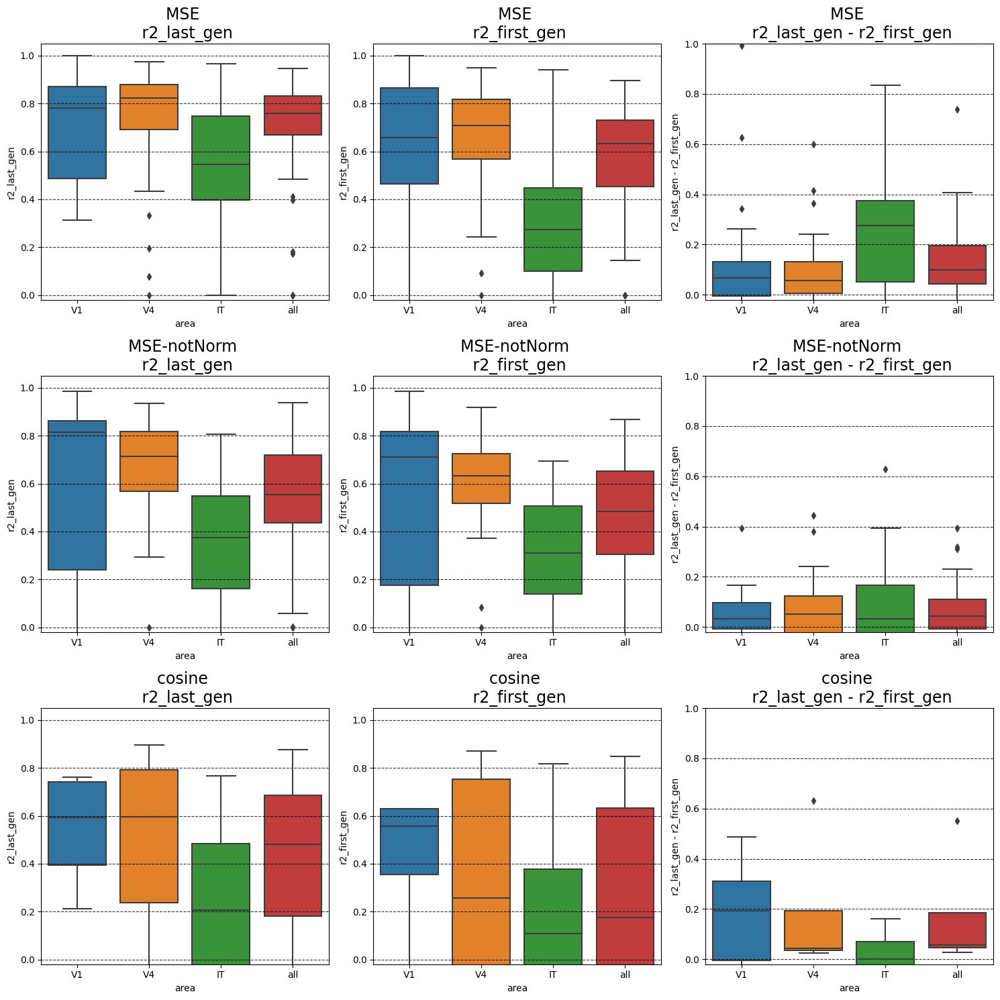

In [ ]:
# let plot the r2_last_gen and r2_first_gen and r2_last_gen - r2_first_gen for each area and in box plot for 'sampling_mods' = 'all' and both 'score_mods'
# so we need a 3*2 grid of box plots

ax_lim = [[-.02, 1.05], [-.02, 1.05], [-.02, 1]]
# add delta r2
recon_sucsessful_r2['r2_last_gen - r2_first_gen'] = recon_sucsessful_r2['r2_last_gen'] - recon_sucsessful_r2['r2_first_gen']
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, cond in enumerate(['r2_last_gen', 'r2_first_gen', 'r2_last_gen - r2_first_gen']):
    for j, score_mod in enumerate(['MSE', 'MSE-notNorm', 'cosine']):
        row_filter = (recon_sucsessful_r2['sampling_mods'] == 'all') &\
            (recon_sucsessful_r2['score_mods'] == score_mod)
        ax[j, i].grid(True, linestyle='--', alpha=.8, color='black')
        sns.boxplot(data=recon_sucsessful_r2[row_filter], x='area', y=cond, ax=ax[j, i], order=['V1', 'V4', 'IT', 'all'])
        ax[j, i].set_title(f'{score_mod} \n {cond}', fontsize=17)
        ax[j, i].set_ylim(ax_lim[i])
        # add grid in background and black color
        
plt.tight_layout()
plt.show()

Text(0.5, 0, 'Slope')

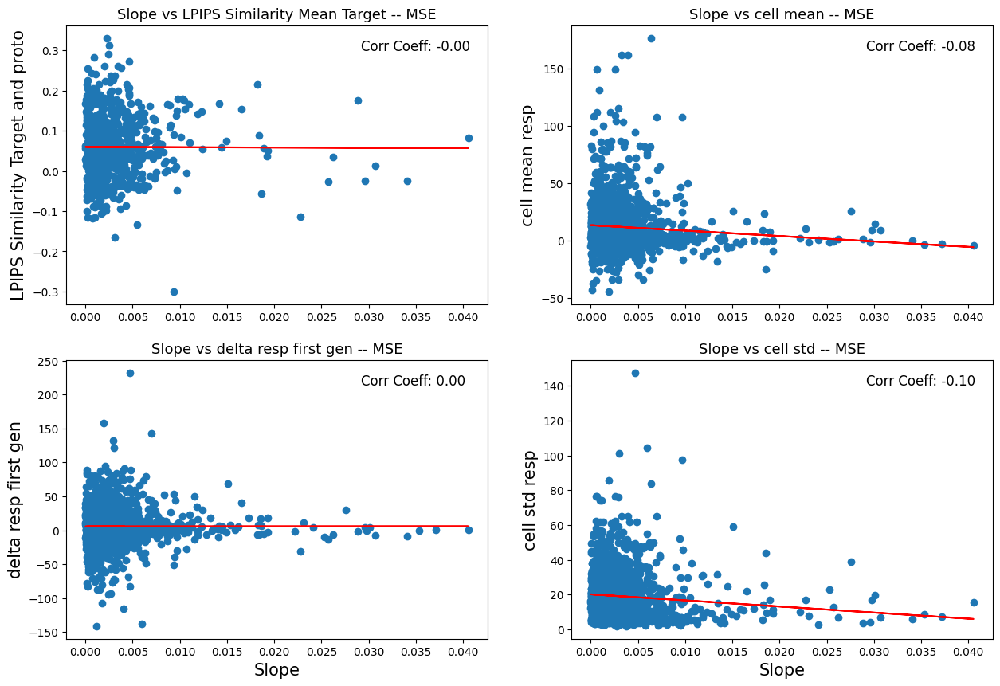

In [13]:
import numpy as np
import matplotlib.pyplot as plt

alpha_cutoff = 0.05
mode = 'MSE'
# let desine a filter 
row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') & \
             (all_recon_exp_results_df['score_mods'] == 'MSE') &\
            (all_recon_exp_results_df['slope_vec'] > 0)
def plot_madoul(x_clean, y_clean, ax):
    ax.scatter(x_clean, y_clean)
    # Line of best fit
    m1, b1 = np.polyfit(x_clean, y_clean, 1)
    ax.plot(x_clean, m1*x_clean + b1, color='red')  # Add line of best fit
    # Calculate the correlation coefficient
    corr_coeff1 = np.corrcoef(x_clean, y_clean)[0, 1]
    ax.text(.7, 0.95, f'Corr Coeff: {corr_coeff1:.2f}', transform=ax.transAxes, fontsize=12, verticalalignment='top')

# First subplot
fig, ax = plt.subplots(2, 2, figsize=(15, 10))


x = all_recon_exp_results_df['slope_vec'][row_filter].values # Ensure it's a numpy array
y = all_recon_exp_results_df['lpips_similarity_mean_target'][row_filter].values - all_recon_exp_results_df['lpips_similarity_mean_init'][row_filter].values
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[0,0])
ax[0,0].set_title(f'Slope vs LPIPS Similarity Mean Target -- {mode}', fontsize=13)
ax[0,0].set_ylabel('LPIPS Similarity Target and proto', fontsize=15)

y = all_recon_exp_results_df['delta_resp_first_gen'][row_filter].values # Ensure it's a numpy array
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[1,0])
ax[1,0].set_title(f'Slope vs delta resp first gen -- {mode}', fontsize=13)
ax[1,0].set_ylabel('delta resp first gen', fontsize=15)
ax[1,0].set_xlabel('Slope', fontsize=15)

y = all_recon_exp_results_df['cell_mean'][row_filter].values # Ensure it's a numpy array
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[0,1])
ax[0,1].set_title(f'Slope vs cell mean -- {mode}', fontsize=13)
ax[0,1].set_ylabel('cell mean resp', fontsize=15)

y = all_recon_exp_results_df['cell_std'][row_filter].values 
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[1,1])
ax[1,1].set_title(f'Slope vs cell std -- {mode}', fontsize=13)
ax[1,1].set_ylabel('cell std resp', fontsize=15)
ax[1,1].set_xlabel('Slope', fontsize=15)







Text(0.5, 0, 'Slope')

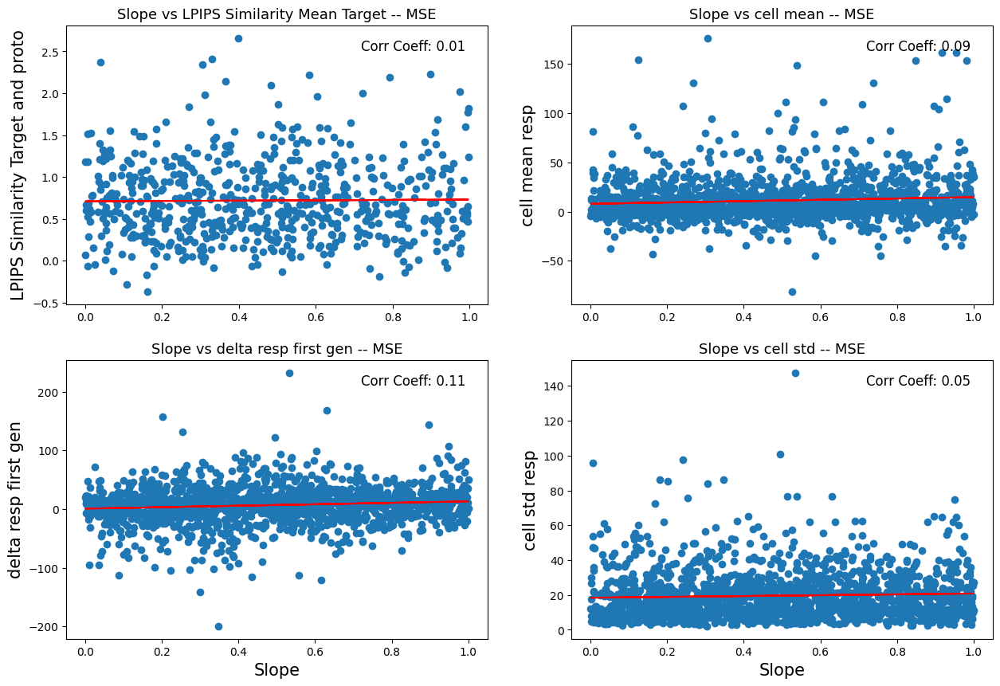

In [20]:
import numpy as np
import matplotlib.pyplot as plt

alpha_cutoff = 0.05
mode = 'MSE'
# let desine a filter 
row_filter = (all_recon_exp_results_df['sampling_mods'] == 'all') & \
             (all_recon_exp_results_df['score_mods'] == 'MSE') &\
            (all_recon_exp_results_df['improvement_index'] > 0)
def plot_madoul(x_clean, y_clean, ax):
    ax.scatter(x_clean, y_clean)
    # Line of best fit
    m1, b1 = np.polyfit(x_clean, y_clean, 1)
    ax.plot(x_clean, m1*x_clean + b1, color='red')  # Add line of best fit
    # Calculate the correlation coefficient
    corr_coeff1 = np.corrcoef(x_clean, y_clean)[0, 1]
    ax.text(.7, 0.95, f'Corr Coeff: {corr_coeff1:.2f}', transform=ax.transAxes, fontsize=12, verticalalignment='top')

# First subplot
fig, ax = plt.subplots(2, 2, figsize=(15, 10))


x = all_recon_exp_results_df['improvement_index'][row_filter].values # Ensure it's a numpy array
y = (all_recon_exp_results_df['L2_target_proto'][row_filter].values - all_recon_exp_results_df['L2_init_target'][row_filter].values)/ all_recon_exp_results_df['L2_init_target'][row_filter].values

x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[0,0])
ax[0,0].set_title(f'Slope vs LPIPS Similarity Mean Target -- {mode}', fontsize=13)
ax[0,0].set_ylabel('LPIPS Similarity Target and proto', fontsize=15)

y = all_recon_exp_results_df['delta_resp_first_gen'][row_filter].values # Ensure it's a numpy array
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[1,0])
ax[1,0].set_title(f'Slope vs delta resp first gen -- {mode}', fontsize=13)
ax[1,0].set_ylabel('delta resp first gen', fontsize=15)
ax[1,0].set_xlabel('Slope', fontsize=15)

y = all_recon_exp_results_df['cell_mean'][row_filter].values # Ensure it's a numpy array
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[0,1])
ax[0,1].set_title(f'Slope vs cell mean -- {mode}', fontsize=13)
ax[0,1].set_ylabel('cell mean resp', fontsize=15)

y = all_recon_exp_results_df['cell_std'][row_filter].values 
x_clean, y_clean = clean_data(x, y)  # Clean data to remove NaNs
plot_madoul(x_clean, y_clean, ax[1,1])
ax[1,1].set_title(f'Slope vs cell std -- {mode}', fontsize=13)
ax[1,1].set_ylabel('cell std resp', fontsize=15)
ax[1,1].set_xlabel('Slope', fontsize=15)





